<a href="https://colab.research.google.com/github/Yuns-u/Credit_Card_Churn_Project/blob/main/Credit_Card_Project_EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 핀테크 분야에서 빼놓을 수 없는 신용카드에 대한 분석을 해보고자 한다.

 `https://leaps.analyttica.com/home` 에서 가져온 데이터를 kaggle을 통해 다운로드 받았다.

 해당 데이터를 분석하여 신용카드를 사용하고 있는 고객의 서비스해지(churn)을 최대한 막아볼 수 있는 비즈니스 인사이트를 발견하고자 한다.

 For the Credit Cards line of business in consumer banking, account attrition is defined as the voluntary intimation of account closure to the bank by the customer. Credit card attrition generally has a negative impact on the cards business P&L with loss of sales and revenue along with asset/balance erosion. There could be many factors affecting account attrition including dissatisfaction with customer service, cards value proposition not meeting customer's expectation, better competitive offers etc. Leveraging the more significant of these factors, a business can understand the likelihood of attrition for each account. This helps in building strategies for proactively countering account attrition.

This simulation allows the learner to analyse a sample of credit card account data with internal and demographic variables to build a predictive model and arrive at the account level probability of attrition of customers in next six months.

In [1]:
from google.colab import files
myfile = files.upload()

Saving BankChurners.csv to BankChurners.csv


## 라이브러리 

In [106]:
import pandas as pd
import numpy as np

#시각화
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set_style('darkgrid')
import plotly.express as px

#정규성 판단
import scipy.stats as stats

In [3]:
df = pd.read_csv('BankChurners.csv')
df

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,0.000093,0.999910
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,0.000057,0.999940
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,0.000021,0.999980
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,0.000134,0.999870
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000,0.000022,0.999980
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10122,772366833,Existing Customer,50,M,2,Graduate,Single,$40K - $60K,Blue,40,3,2,3,4003.0,1851,2152.0,0.703,15476,117,0.857,0.462,0.000191,0.999810
10123,710638233,Attrited Customer,41,M,2,Unknown,Divorced,$40K - $60K,Blue,25,4,2,3,4277.0,2186,2091.0,0.804,8764,69,0.683,0.511,0.995270,0.004729
10124,716506083,Attrited Customer,44,F,1,High School,Married,Less than $40K,Blue,36,5,3,4,5409.0,0,5409.0,0.819,10291,60,0.818,0.000,0.997880,0.002118
10125,717406983,Attrited Customer,30,M,2,Graduate,Unknown,$40K - $60K,Blue,36,4,3,3,5281.0,0,5281.0,0.535,8395,62,0.722,0.000,0.996710,0.003294


In [4]:
df.columns

Index(['CLIENTNUM', 'Attrition_Flag', 'Customer_Age', 'Gender',
       'Dependent_count', 'Education_Level', 'Marital_Status',
       'Income_Category', 'Card_Category', 'Months_on_book',
       'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio',
       'Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1',
       'Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2'],
      dtype='object')

In [5]:
#뒤의 두 칼럼
#('Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1',
#'Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2')
#은 raw data가 아니므로 제거해준다.

df = df.drop(columns=['Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1',
                      'Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2'])
df

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10122,772366833,Existing Customer,50,M,2,Graduate,Single,$40K - $60K,Blue,40,3,2,3,4003.0,1851,2152.0,0.703,15476,117,0.857,0.462
10123,710638233,Attrited Customer,41,M,2,Unknown,Divorced,$40K - $60K,Blue,25,4,2,3,4277.0,2186,2091.0,0.804,8764,69,0.683,0.511
10124,716506083,Attrited Customer,44,F,1,High School,Married,Less than $40K,Blue,36,5,3,4,5409.0,0,5409.0,0.819,10291,60,0.818,0.000
10125,717406983,Attrited Customer,30,M,2,Graduate,Unknown,$40K - $60K,Blue,36,4,3,3,5281.0,0,5281.0,0.535,8395,62,0.722,0.000


# Profile

In [6]:
pip install -U pandas-profiling

     |████████████████████████████████| 261 kB 9.5 MB/s 
     |████████████████████████████████| 303 kB 45.3 MB/s 
     |████████████████████████████████| 62 kB 712 kB/s 
     |████████████████████████████████| 10.1 MB 56.9 MB/s 
     |████████████████████████████████| 675 kB 70.6 MB/s 
     |████████████████████████████████| 3.1 MB 42.8 MB/s 
     |████████████████████████████████| 102 kB 12.0 MB/s 
     |████████████████████████████████| 596 kB 70.6 MB/s 
     |████████████████████████████████| 812 kB 66.2 MB/s 
     |████████████████████████████████| 38.1 MB 164 kB/s 
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27098 sha256=ce26d5834964588883b825278cfa5244a6ee05bf86bb79753752e8be7cc8dfd7
  Stored in directory: /root/.cache/pip/wheels/70/e1/52/5b14d250ba868768823940c3229e9950d201a26d0bd3ee8655
  Created wheel for imagehash: filename=ImageHash-4.2.1-py2.py3-none-any.whl size=295207 sha256=e3905f641f7aaa89cd5043a1f9c28e0dfa4054e4e1b9cd59d3a7a5125b1c3d56
 

In [7]:
import pandas_profiling

In [8]:
df.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# columns에 대해 살펴보기

총 21개의 feature들이 있다.

각 feature들이 어떠한 내용을 가지고 있는지 살펴보고 데이터를 전처리하면서 내용을 파악해보고자 한다.

In [9]:
df.dtypes

CLIENTNUM                     int64
Attrition_Flag               object
Customer_Age                  int64
Gender                       object
Dependent_count               int64
Education_Level              object
Marital_Status               object
Income_Category              object
Card_Category                object
Months_on_book                int64
Total_Relationship_Count      int64
Months_Inactive_12_mon        int64
Contacts_Count_12_mon         int64
Credit_Limit                float64
Total_Revolving_Bal           int64
Avg_Open_To_Buy             float64
Total_Amt_Chng_Q4_Q1        float64
Total_Trans_Amt               int64
Total_Trans_Ct                int64
Total_Ct_Chng_Q4_Q1         float64
Avg_Utilization_Ratio       float64
dtype: object

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   CLIENTNUM                 10127 non-null  int64  
 1   Attrition_Flag            10127 non-null  object 
 2   Customer_Age              10127 non-null  int64  
 3   Gender                    10127 non-null  object 
 4   Dependent_count           10127 non-null  int64  
 5   Education_Level           10127 non-null  object 
 6   Marital_Status            10127 non-null  object 
 7   Income_Category           10127 non-null  object 
 8   Card_Category             10127 non-null  object 
 9   Months_on_book            10127 non-null  int64  
 10  Total_Relationship_Count  10127 non-null  int64  
 11  Months_Inactive_12_mon    10127 non-null  int64  
 12  Contacts_Count_12_mon     10127 non-null  int64  
 13  Credit_Limit              10127 non-null  float64
 14  Total_

## CLIENTNUM

Client number. Unique identifier for the customer holding the account

사용자들을 구분해주는 ID역할을 한다. 따라서 중복되는 숫자가 있다면 제거해야할 것이다.

In [11]:
df['CLIENTNUM'].duplicated()

0        False
1        False
2        False
3        False
4        False
         ...  
10122    False
10123    False
10124    False
10125    False
10126    False
Name: CLIENTNUM, Length: 10127, dtype: bool

In [12]:
display(df[df['CLIENTNUM'].duplicated()])

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio


해당 데이터에서는 유저가 중복되는 경우는 없는 것으로 보인다.
따라서 이 칼럼은 삭제해도 괜찮을 것이다.

## Attrition_Flag

Internal event (customer activity) variable - if the account is closed then 1 else 0

- Existing Customer: 서비스 잔류 고객 (0으로 표시)
- Attrited Customer: 서비스 이탈 고객 (1로 표시)

In [13]:
df['Attrition_Flag'].unique()

array(['Existing Customer', 'Attrited Customer'], dtype=object)

In [14]:
sns.countplot(data=df, x=df['Attrition_Flag'])

이 프로젝트의 목적은 서비스를 해지하는 고객을 줄이는 것이다. 

따라서 추후 서비스를 해지하는 'Attrited Customer'를 타깃인 1로, 그렇지 않은 고객을 0으로 분류하고자 한다.

In [15]:
df['Attrition_Flag'].value_counts()

Existing Customer    8500
Attrited Customer    1627
Name: Attrition_Flag, dtype: int64

In [16]:
existing_percent = (8500/10127)*100
attrited_percent = (1627/10127)*100

print(f"Existing customers' percent: {round(existing_percent,3)}%")
print(f"Attrited customers' percent: {round(attrited_percent,3)}%")

Existing customers' percent: 83.934%
Attrited customers' percent: 16.066%


해당 서비스의 이탈율은 16.066% 정도로 평균적인 신용카드 해지율인 13%(출처: https://www.pymnts.com/subscriptions/2019/churn-and-regional-preferences-challenge-subscription-commerce/)보다 높다고 할 수 있다.

In [17]:
# 타겟 칼럼의 타겟인 Atrrited Customer를 1로, 그렇지 않은 고객을 0으로 바꿔주기
df['Attrition_Flag'] = df['Attrition_Flag'].replace('Existing Customer',0)
df['Attrition_Flag'] = df['Attrition_Flag'].replace('Attrited Customer',1)
df['Attrition_Flag']

0        0
1        0
2        0
3        0
4        0
        ..
10122    0
10123    1
10124    1
10125    1
10126    1
Name: Attrition_Flag, Length: 10127, dtype: int64

In [18]:
sns.countplot(data=df, x=df['Attrition_Flag'])

## Customer_Age

Demographic variable - Customer's Age in Years

In [19]:
df['Customer_Age'].describe()

count    10127.000000
mean        46.325960
std          8.016814
min         26.000000
25%         41.000000
50%         46.000000
75%         52.000000
max         73.000000
Name: Customer_Age, dtype: float64

In [20]:
sns.boxplot(x=df['Customer_Age'],data=df, width=0.5)

In [21]:
sns.histplot(x=df['Customer_Age'])

## Gender 🍏

Demographic variable - M=Male, F=Female

In [22]:
df['Gender'].value_counts()

F    5358
M    4769
Name: Gender, dtype: int64

In [23]:
sns.countplot(data=df, x=df['Gender'])

In [24]:
#타겟인 Attrition_Flag와 연관지어보기
px.histogram(df, x='Gender', color ="Attrition_Flag",
                   barmode='group',color_discrete_sequence={
                0: "Blue",
                1: "Red"})

In [25]:
F_attritedpercent = (930/5358)*100
M_attritedpercent = (697/4769)*100

print(f"Attrited Male customers' percent: {round(M_attritedpercent,3)}%")
print(f"Attrited Female customers' percent: {round(F_attritedpercent,3)}%")

Attrited Male customers' percent: 14.615%
Attrited Female customers' percent: 17.357%


남녀 성비가 유의미하게 차이나지 않으며 해지한 사람의 비율도 성별에 큰 영향을 받지 않는 것으로 보인다.
- H0: 성별에 따라 해지율의 차이가 없을 것이다.
- H1: 성별에 따라 해지율의 차이가 있을 것이다.

In [26]:
#stats.ttest_ind(샘플의데이터1,샘플의데이터2, 
#                axis=0, equal_var=True, 
#                nan_policy='propagate',
#                Alternative='two-sided')

## Dependent_count

Demographic variable - Number of dependents

In [27]:
df['Dependent_count'].value_counts()

3    2732
2    2655
1    1838
4    1574
0     904
5     424
Name: Dependent_count, dtype: int64

부양가족 수는 나이나 성별과 유의미한 관계가 있을 것 같다.
20대 쪽의 어리거나 60대 이상의 고령층이면 부양가족의 수는 적을 것 같고, 30대~50대에 부양가족의 수가 많을 것 같다.

In [28]:
sns.histplot(x=df['Dependent_count'])

In [29]:
#타겟인 Attrition_Flag와 연관지어보기
px.histogram(df, x='Dependent_count', color ="Attrition_Flag",
                   barmode='group',color_discrete_sequence={
                0: "Blue",
                1: "Red"})

## Education_Level

Demographic variable - Educational Qualification of the account holder (example: high school, college graduate, etc.)

In [30]:
df['Education_Level'].value_counts()

Graduate         3128
High School      2013
Unknown          1519
Uneducated       1487
College          1013
Post-Graduate     516
Doctorate         451
Name: Education_Level, dtype: int64

In [31]:
sns.catplot(x='Education_Level',
            data=df, 
            kind= 'count',
            order=['Uneducated','High School','College','Graduate','Post-Graduate','Doctorate','Unknown'],
            height=8.27, aspect=11.7/8.27
            )

In [32]:
#타겟인 Attrition_Flag와 연관지어보기
px.histogram(df, x='Education_Level', color ="Attrition_Flag", 
                   barmode='group',color_discrete_sequence={
                0: "Blue",
                1: "Red"})

## Marital_Status 🍎

Demographic variable - Married, Single, Divorced, Unknown

In [33]:
df['Marital_Status'].value_counts()

Married     4687
Single      3943
Unknown      749
Divorced     748
Name: Marital_Status, dtype: int64

절반정도가 결혼을 한 것으로 보인다.

In [34]:
plt.pie(x=df['Marital_Status'].value_counts(),
        labels=['Married', 'Single', 'Unknown','Divorced'],
        autopct='%1.0f%%')
plt.title("Customers' Marital Status Pie Chart")

Text(0.5, 1.0, "Customers' Marital Status Pie Chart")

In [35]:
px.histogram(df, x='Marital_Status', color ="Attrition_Flag",
                   barmode='group',color_discrete_sequence={
                0: "Blue",
                1: "Red"})

In [36]:
668/4687

0.14252186899935992

In [37]:
709/3943

0.17981232564037536

미혼과 기혼의 경우 해지율이 비슷하다. 

## Income_Category

Demographic variable - Annual Income Category of the account holder (< $40K, $40K - 60K, $60K - $80K, $80K-$120K, >

달러 기준으로 나뉘어 있다.

- `Less than $40K`

- `$40K - $60K`
- `$60K - $80K`
- `$80K - $120K`
- `$120K +`
- `Unknown`

In [38]:
df['Income_Category'].value_counts()

Less than $40K    3561
$40K - $60K       1790
$80K - $120K      1535
$60K - $80K       1402
Unknown           1112
$120K +            727
Name: Income_Category, dtype: int64

In [39]:
sns.catplot(x='Income_Category',
            data=df, 
            kind= 'count',
            order=['Less than $40K','$40K - $60K','$60K - $80K','$80K - $120K','$120K +','Unknown'],
            height=8.27, aspect=11.7/8.27
            )

In [40]:
px.histogram(df, x='Income_Category', color ="Attrition_Flag",
                   barmode='group',color_discrete_sequence={
                0: "Blue",
                1: "Red"})

소득을 알 수 없는 사람이 해지할 경우가 의외로 적다. 해당 카드의 사용자가 사용자과 소유자가 다르거나(학생의 경우 부모의 카드를 사용하는 경우 등) 일정한 직업이 없어 정확한 소득수준을 파악할 수 없을 수 있다.(프리랜서의 경우 매달 수입이 달라져 불안정하여 신용카드를 만들 수 없기도 한다.) 소득은 신용카드비용의 상환 능력과 직결되는 요소인만큼 소득을 정확하게 파악하는 것이 예측의 정확성을 높히고 비즈니스적 인사이트를 추출하는 데에 도움이 될 것이다.

## Card_Category

Product Variable - Type of Card (Blue, Silver, Gold, Platinum)

In [41]:
df['Card_Category'].value_counts()

Blue        9436
Silver       555
Gold         116
Platinum      20
Name: Card_Category, dtype: int64

In [42]:
plt.pie(x=df['Card_Category'].value_counts(),
        labels=['Blue', 'Silver','Gold','Platinum'],
        autopct='%0.1f%%',
        labeldistance=1.5)
plt.title("Customers' Card Category Pie Chart")

Text(0.5, 1.0, "Customers' Card Category Pie Chart")

In [43]:
sns.catplot(x='Card_Category',
            data=df, 
            kind= 'count',
            order=['Blue', 'Silver','Gold','Platinum'],
            )

In [44]:
px.histogram(df, x='Card_Category', color ="Attrition_Flag",
                   barmode='group',color_discrete_sequence={
                0: "Blue",
                1: "Red"})

In [45]:
#df.groupby(by='Card_Category')

카드 등급별로는 고객의 특성이 뚜렷할 것 같다.
등급에 따라 소비액, 신용한도, 소득이 다른 것인지 혹은 상품의 차이인지 파악한다면 좋은 고객의 특성을 파악할 수 있을 것으로 보인다.

# ----여기서부터는 해당 신용카드 이용에 대한 지표가 많다----

고객의 인구통계적 지표뿐만 아니라 카드이용비의 상환 능력 및 소비습관 역시 중요한 지표가 된다.
위에서는 성별, 부양가족수, 카드 종류 등 사용자의 사회적 특성에 가까운 지표들이라면 아래는 사용자의 카드 사용 형태를 알 수 있는 지표들이다.

## Months_on_book

Number of months for which the customer has been on the books of the bank in the past 12 months

고객의 은행 이용 기간을 회계기간으로 나타낸 것으로 36이라면 36개월동안 신용카드를 사용하면서 은행에 비용을 지불한 것이다.

 the number of complete calendar months that have elapsed since calendar month in which the Origination Date of such Purchased Loan occurred, measured at the end of each calendar month.

In [46]:
df['Months_on_book'].describe()

count    10127.000000
mean        35.928409
std          7.986416
min         13.000000
25%         31.000000
50%         36.000000
75%         40.000000
max         56.000000
Name: Months_on_book, dtype: float64

In [47]:
sns.histplot(x=df['Months_on_book'])

In [48]:
sns.boxplot(x=df['Months_on_book'],data=df, width=0.5)

In [49]:
sns.violinplot(x=df['Months_on_book'],data=df, width=0.5)

In [50]:
px.histogram(df, x='Months_on_book', color ="Attrition_Flag",
                   barmode='group',color_discrete_sequence={
                0: "Blue",
                1: "Red"})

In [51]:
df['Months_on_book'].value_counts().head(15)

36    2463
37     358
34     353
38     347
39     341
40     333
31     318
35     317
33     305
30     300
41     297
32     289
28     275
43     273
42     271
Name: Months_on_book, dtype: int64

해당 은행의 서비스는 5년 이상했음에도 불구하고 3년 전에 약 25%의 사용자가 유입되었다.
3년(36개월) 전에 어떠한 이유로 고객이 유입되었는지 살펴보면 고객 유입률을 향상하는 데에 도움이 될 것이라 생각된다.

## Total_Relationship_Count 🍎

Total relationships or accounts the customer has with the bank

은행에 대한 고객의 충성도를 나타낼 수 있는 지표인 Total_Relationship Level과 연관된 지표.
은행마다 TRL을 계산하는 정도는 다른 것으로 보인다.

해당 은행에 고객이 몇 개의 계좌를 가지고 있는지에 대한 수치이다.

In [52]:
df['Total_Relationship_Count'].value_counts()

3    2305
4    1912
5    1891
6    1866
2    1243
1     910
Name: Total_Relationship_Count, dtype: int64

In [53]:
sns.histplot(x=df['Total_Relationship_Count'])

In [54]:
px.histogram(df, x='Total_Relationship_Count', color ="Attrition_Flag",
                   barmode='group',color_discrete_sequence={
                0: "Blue",
                1: "Red"})

## 'Months_Inactive_12_mon'
Number of months in which the customer has not carried out any transactions using the card of the company

최대 6개월 동안 해당 카드를 사용하지 않은 것으로 보인다.
카드를 사용하지 않을수록 해지율이 높을까? 

In [55]:
df['Months_Inactive_12_mon'].value_counts()

3    3846
2    3282
1    2233
4     435
5     178
6     124
0      29
Name: Months_Inactive_12_mon, dtype: int64

In [56]:
sns.histplot(x=df['Months_Inactive_12_mon'])

In [57]:
px.histogram(df, x='Months_Inactive_12_mon', color ="Attrition_Flag",
                   barmode='group',color_discrete_sequence={
                0: "Blue",
                1: "Red"})

## 'Contacts_Count_12_mon' 🍎

Number of times the customer has contacted the company in the past 12 months.
지난 1년 간 고객이 회사에 연락을 한 횟수.
고객이 연락을 많이 한다는 것은 사용하는 데에 문제가 발생했기 때문이라면 해지율이 높지 않을까?

In [58]:
sns.histplot(x=df['Contacts_Count_12_mon'])

In [59]:
px.histogram(df, x='Contacts_Count_12_mon', color ="Attrition_Flag",
                   barmode='group',color_discrete_sequence={
                0: "Blue",
                1: "Red"})

## 'Credit_Limit'🍎

Credit limit that the customer has kept for the card
해당 카드에 대한 고객의 신용 한도.

신용한도가 높다는 것은 고객이 카드비용을 제 때 잘 지불했으며 카드대출을 갚을 능력이 있다고 회사가 판단했을 것이므로 education level, income category, card category와 양의 관계를 가질 것 같다. 

신용한도를 예상해보는 것도 좋은 프로젝트가 될 것 같다.

In [60]:
df['Credit_Limit'].describe()

count    10127.000000
mean      8631.953698
std       9088.776650
min       1438.300000
25%       2555.000000
50%       4549.000000
75%      11067.500000
max      34516.000000
Name: Credit_Limit, dtype: float64

In [61]:
sns.histplot(x=df['Credit_Limit'])

In [62]:
px.histogram(df, x='Credit_Limit', color ="Attrition_Flag",
                   barmode='group',color_discrete_sequence={
                0: "Blue",
                1: "Red"})

신용한도가 높은 고객은 미납대금이 많지 않고 안정적인 수익을 가진 고객일 확률이 높다. 따라서 해당 고객들의 해지원인을 파악하는 것이 필요할 것으로 보인다.

## 'Total_Revolving_Bal'

Total revolving balance of the customer.

revolving balance is the portion of credit card spending that goes unpaid at the end of a billing cycle

신용카드 비용을 지불할 때 고객이 지불하지 않은 금액을 나타낸다.
할부로 구매했을 때 지불한 금액 등이 여기에 포함되며 revolving balance가 있다는 말은 추후 지불하지 않은 이 금액에 대한 이자도 지불해야한다는 것이다.

이 금액이 높으면 신용카드의 신용에 지나치게 의존하고 있다는 뜻이 되기도 하며 이는 신용 점수에 영향을 미치기도 한다.

해당 금액이 높을수록 credit limit이 낮을 것으로 예상된다.


In [63]:
sns.histplot(x=df['Total_Revolving_Bal'])

In [64]:
px.histogram(df, x='Total_Revolving_Bal', color ="Attrition_Flag",
                   barmode='group',color_discrete_sequence={
                0: "Blue",
                1: "Red"})

## 'Avg_Open_To_Buy' 🍎
신용한도 내에서 사용할 수 있는 금액의 수치
 Open to Buy Credit Line (Average of last 12 months)

In [65]:
df['Avg_Open_To_Buy'].describe()

count    10127.000000
mean      7469.139637
std       9090.685324
min          3.000000
25%       1324.500000
50%       3474.000000
75%       9859.000000
max      34516.000000
Name: Avg_Open_To_Buy, dtype: float64

In [66]:
sns.histplot(x=df['Avg_Open_To_Buy'])

In [67]:
px.histogram(df, x='Avg_Open_To_Buy', color ="Attrition_Flag",
                   barmode='group',color_discrete_sequence={
                0: "Blue",
                1: "Red"})

## 'Total_Amt_Chng_Q4_Q1'

represents how much the customer increased their expenditure when comparing the 4th quarter agains the 1st.

1분기와 비교했을 때 4분기에 고객이 얼마나 더 많이 소비를 했는지를 비율로 나타낸다.
(4분기 소비액/1분기 소비액) 이 수치가 1을 넘으면 연말에 가까울수록 소비가 늘었다는 것이다

In [68]:
sns.histplot(x=df['Total_Amt_Chng_Q4_Q1'])

In [69]:
px.histogram(df, x='Total_Amt_Chng_Q4_Q1', color ="Attrition_Flag",
                   barmode='group',color_discrete_sequence={
                0: "Blue",
                1: "Red"})

## 'Total_Trans_Amt' 🍎

12개월동안 사용자가 얼마만큼의 금액을 신용카드로 사용했는지를 나타내주는 수치

the sum of transactions one has done in the last 12 months. This basically tells us the total usage of a credit card by the user

In [70]:
sns.histplot(x=df['Total_Trans_Amt'])

In [71]:
sns.boxplot(x=df['Total_Trans_Amt'],data=df, width=0.5)

사용금액이 많은 고객이 많은데, 해당 고객들의 상환능력을 평가한다면 좋은 고객인지 아닌지를 판단할 수 있을 것이다.

In [72]:
sns.violinplot(x=df['Total_Trans_Amt'],data=df, width=0.5)

In [73]:
px.histogram(df, x='Total_Trans_Amt', color ="Attrition_Flag",
                   barmode='group',color_discrete_sequence={
                0: "Blue",
                1: "Red"})

## 'Total_Trans_Ct' 🍎

사용자가 신용카드를 지난 12개월 동안 몇 번 사용했는지에 대한 지표
Total Transaction Count (Last 12 months)

In [74]:
sns.histplot(x=df['Total_Trans_Ct'])

In [75]:
px.histogram(df, x='Total_Trans_Ct', color ="Attrition_Flag",
                   barmode='group',color_discrete_sequence={
                0: "Blue",
                1: "Red"})

## 'Total_Ct_Chng_Q4_Q1'

1분기와 비교했을 때 4분기에 고객이 얼마나 더 많이 소비를 했는지를 수치로 나타낸다. 

In [76]:
sns.histplot(x=df['Total_Ct_Chng_Q4_Q1'])

In [77]:
px.histogram(df, x='Total_Ct_Chng_Q4_Q1', color ="Attrition_Flag",
                   barmode='group',color_discrete_sequence={
                0: "Blue",
                1: "Red"})

## 'Avg_Utilization_Ratio' 🍎

Average Card Utilization Ratio (Amount Used/Credit Limit)

신용한도 내에서 사용자가 얼마나 더 신용카드를 사용할 수 있는지를 비율로 나타낸다.

Avg_Utilization_Ratio represents how much of the available credit the customer spent. This is useful for calculating credit scores, as keeping it below 30% is supposed to help increase the scoring.

total utilization ratio = total debt / total available credit
(Avg_Open_To_Buy/Credit_Limit) + Avg_Utilization_Ratio = 1

해당 비율이 높을수록 한도소진율이 낮은 것이므로 좋은 고객일 확률이 높을 것이다.

In [78]:
sns.histplot(x=df['Avg_Utilization_Ratio'])

In [79]:
px.histogram(df, x='Avg_Utilization_Ratio', color ="Attrition_Flag",
                   barmode='group',color_discrete_sequence={
                0: "Blue",
                1: "Red"})

# EDA

이 신용카드 서비스의 매출을 높히기 위해서는 이탈율을 낮추는 것도 중요하겠지만 좋은 고객(상환을 잘 하며 신용등급이 좋은 고객)의 이탈율을 최소화하고 그러한 고객의 유입을 증진시키는 것이 필요할 것이다.

## 이상치 제거하기

In [80]:
#이상치를 연속형 데이터에서 찾아보기
continuous_feature = [feature for feature in df.columns if df[feature].dtypes != 'O']
Colors = ['#f03a17']

In [81]:
#연속형 데이터의 히스토그램과 왜도, 첨도를 확인해보기
for feature in continuous_feature:
    data=df.copy()
    fig = px.histogram(df, x= feature,title= 'Distribution of '+feature, color_discrete_sequence= Colors)
    fig.show()
    print("Skewness: %f" % df[feature].skew())
    print("Kurtosis: %f" % df[feature].kurt())

Skewness: 0.995601
Kurtosis: -0.615640


Skewness: 1.848449
Kurtosis: 1.417043


Skewness: -0.033605
Kurtosis: -0.288620


Skewness: -0.020826
Kurtosis: -0.683017


Skewness: -0.106565
Kurtosis: 0.400100


Skewness: -0.162452
Kurtosis: -1.006131


Skewness: 0.633061
Kurtosis: 1.098523


Skewness: 0.011006
Kurtosis: 0.000863


Skewness: 1.666726
Kurtosis: 1.808989


Skewness: -0.148837
Kurtosis: -1.145992


Skewness: 1.661697
Kurtosis: 1.798617


Skewness: 1.732063
Kurtosis: 9.993501


Skewness: 2.041003
Kurtosis: 3.894023


Skewness: 0.153673
Kurtosis: -0.367163


Skewness: 2.064031
Kurtosis: 15.689293


Skewness: 0.718008
Kurtosis: -0.794972


In [82]:
name_ls = []
skewness_ls = []
kurtosis_ls = []

for feature in continuous_feature:
    data=df.copy()

    name_ls.append(feature)
    skewness_ls.append(df[feature].skew())
    kurtosis_ls.append(df[feature].kurt())
    #print(f"Skewness of {feature}: {df[feature].skew()}%" )
    #print(f"Kurtosis of {feature}: {df[feature].kurt()}%")

    outlier_ls =  list(zip(name_ls,skewness_ls,kurtosis_ls))

outlier_df = pd.DataFrame(outlier_ls, columns =['Name', 'skewness', 'kurtosis'])
outlier_df

,Name,skewness,kurtosis
0,CLIENTNUM,0.995601,-0.615640
1,Attrition_Flag,1.848449,1.417043
2,Customer_Age,-0.033605,-0.288620
3,Dependent_count,-0.020826,-0.683017
4,Months_on_book,-0.106565,0.400100
5,Total_Relationship_Count,-0.162452,-1.006131
6,Months_Inactive_12_mon,0.633061,1.098523
7,Contacts_Count_12_mon,0.011006,0.000863
8,Credit_Limit,1.666726,1.808989
9,Total_Revolving_Bal,-0.148837,-1.145992


자료형이 연속형인 경우 왜도와 첨도를 위와 같이 나타낼 수 있다.
(이 때, `'Attrition_Flag'`는 연속형이 아니므로 분석에서 제외해준다.)

- 왜도(skewness): 데이터가 정규분포를 얼마나 따르느냐와 관련된 지표로 95%의 유의수준으로 절댓값 0.5를 기준으로 대칭적이라고 할 수 있으며 절댓값이 1을 넘으면 한쪽으로 편중되었다고 할 수 있다.
- 첨도(kurtosis): 데이터의 분포에 존재하는 outlier들의 척도라고 할 수 있다. Kurtosis가 낮으면 데이터 분포의 꼬리가 상대적으로 두툼하다는 뜻인데 이는 outlier가 상대적으로 적다는 뜻이라고 할 수 있다. 

Snedecor & Cochran 표를 따르면 표본이 200개 이상일 때 왜도의 95% 신뢰구간은 `-0.179 ~ 0.179`이며, 첨도의 95% 신뢰구간은 `-0.33 ~ 0.37`이다.

In [83]:
for i in range(0,len(outlier_df)):
  if abs(outlier_df['skewness'][i]) >= 0.179:
    print(i,outlier_df['Name'][i],'                ', outlier_df['skewness'][i])

0 CLIENTNUM                  0.9956010103361872
1 Attrition_Flag                  1.8484488579523548
6 Months_Inactive_12_mon                  0.6330611289713137
8 Credit_Limit                  1.666725807993647
10 Avg_Open_To_Buy                  1.6616965459311595
11 Total_Amt_Chng_Q4_Q1                  1.7320634114286024
12 Total_Trans_Amt                  2.0410034025756936
14 Total_Ct_Chng_Q4_Q1                  2.0640305679077477
15 Avg_Utilization_Ratio                  0.7180079967731994


In [84]:
for i in range(0,len(outlier_df)):
  if outlier_df['kurtosis'][i] <= -0.33 or outlier_df['kurtosis'][i] >= 0.37:
    print(i,outlier_df['Name'][i],'                ', outlier_df['kurtosis'][i])

0 CLIENTNUM                  -0.6156397044233493
1 Attrition_Flag                  1.4170429959116353
3 Dependent_count                  -0.6830166530893709
4 Months_on_book                  0.40010012019986707
5 Total_Relationship_Count                  -1.0061305074402487
6 Months_Inactive_12_mon                  1.098522613771138
8 Credit_Limit                  1.8089893357093434
9 Total_Revolving_Bal                  -1.145991781532597
10 Avg_Open_To_Buy                  1.7986172957122664
11 Total_Amt_Chng_Q4_Q1                  9.993501178599232
12 Total_Trans_Amt                  3.8940234056985163
13 Total_Trans_Ct                  -0.36716324112759624
14 Total_Ct_Chng_Q4_Q1                  15.689292901407043
15 Avg_Utilization_Ratio                  -0.7949719514980287


신뢰구간 95% 기준에서 왜도의 신뢰구간을 벗어난 것들은 첨도의 신뢰구간도 벗어나있다. 
즉, 왜도가 신뢰구간을 벗어난 항목들은 정규분포라고 볼 수 없다.

이에 따르면 `'CLIENTNUM','Attrition_Flag','Months_Inactive_12_mon','Credit_Limit','Avg_Open_To_Buy','Total_Amt_Chng_Q4_Q1','Total_Trans_Amt','Total_Ct_Chng_Q4_Q1','Avg_Utilization_Ratio'`는 정규분포를 따르지 않고 한 쪽으로 치우쳐져 있는 분포를 가지고 있다고 할 수 있다. 여기에서 `'Attrition_Flag'`는 연속형이 아니므로 분석에서 제외해줘야한다.

이 중에서 `'CLIENTNUM'`의 경우 ID의 역할을 하므로 분석에서 유의미한 중요도를 갖는다고 하기 어렵다. 그러나 일반적으로 신용등급에 영향을 주는 `'Avg_Utilization_Ratio'`는 이 분석에서 중요한 요인이 될 가능성이 높다.



## 불필요한 feature 제거하기 및 수정하기

- CLIENTNUM : 해당 feature는 사용자들을 구분하기 위한 ID역할을 하며 해당 데이터에는 중복된 값이 없으므로 불필요하다. 특성의 중요도가 낮으며 cardinality가 높으므로 해당 특성을 삭제해준다.

In [85]:
df = df.drop(columns='CLIENTNUM')
df.head()

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,0,45,M,3,High School,Married,$60K - $80K,Blue,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,0,49,F,5,Graduate,Single,Less than $40K,Blue,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,0,51,M,3,Graduate,Married,$80K - $120K,Blue,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,0,40,F,4,High School,Unknown,Less than $40K,Blue,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,0,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000


- Customer_Age : 사용자의 정확한 나이가 영향을 주는 것보다 연령층으로 판단하는 것이 현실세계에 더 적합할 것이다. 예를 들어 42.45세 미만의 사람들이 42.45세 이상보다 대출상한이 낮다보다 40대 미만의 연령층은 40대 이상보다 대출상한이 낮다라고 표현하는 것이 더 현실데이터에 적용하기 적합하기 때문이다. 연령층을 0, 1, 2, 3 ... 으로 정수화하여 계층별로 표현하는 것이 더 적합할 것이라 판단한다.

In [86]:
#사용자 함수로 신용카드 사용자의 나이 그룹을 연령층으로 바꿔주기
#최저연령: 26, 최고연령:73
def age_group(df):
  df['Age_Group'] = 0

  for index in range(len(df)):
    age = df['Customer_Age'][index]

    if age < 20:
      assert age <0 , 'age should be more than 0'
      df['Age_Group'][index] = int(10)

    elif age >= 20 and age <30:
      df['Age_Group'][index] = int(20)

    elif age >= 30 and age <40:
      df['Age_Group'][index] = int(30)
    
    elif age >= 40 and age <50:
      df['Age_Group'][index] = int(40)
    
    elif age >= 50 and age <60:
      df['Age_Group'][index] = int(50)

    elif age >= 60 and age <70:
      df['Age_Group'][index] = int(60)

    elif age >= 70 and age <80:
      df['Age_Group'][index] = int(70)

    else:
      df['Age_Group'][index] = int(80)

  return df

In [87]:
#위의 사용자 함수 실행
df = age_group(df)
df.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:20: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:17: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:26: SettingWithCopyWarning:


A value is tryi

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Age_Group
0,0,45,M,3,High School,Married,$60K - $80K,Blue,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,40
1,0,49,F,5,Graduate,Single,Less than $40K,Blue,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,40
2,0,51,M,3,Graduate,Married,$80K - $120K,Blue,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,50
3,0,40,F,4,High School,Unknown,Less than $40K,Blue,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,40
4,0,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000,40


In [109]:
#customer_age 제거하기
df = df.drop(columns='Customer_Age')

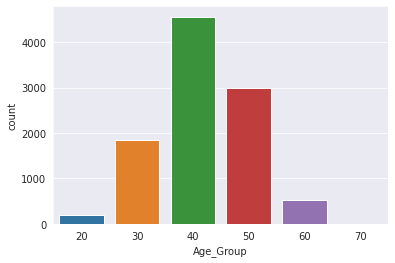

In [110]:
sns.countplot(data=df, x='Age_Group')

In [89]:
#타겟인 Attrition_Flag와 연관지어보기
px.histogram(df, x="Age_Group", color ="Attrition_Flag",
                   barmode='group',color_discrete_sequence={
                0: "Blue",
                1: "Red"})

사람이 많은 연령층일수록 해지한 사람이 많다는 정도의 정보를 얻을 수 있다.
해지율과 연령층이 크게 유의미하지 않는 것으로 보인다.

- Gender: 여성과 남성의 차이가 있을까?

- Dependent_count

In [90]:
#타겟인 Attrition_Flag와 연관지어보기
px.histogram(df, x='Dependent_count', color ="Attrition_Flag",
                   barmode='group',color_discrete_sequence={
                0: "Blue",
                1: "Red"})

- Education_Level

## 새로운 feature 만들기

- Avg_Revolving_Bal_mon : 월평균적으로 상환하지 못하는 금액.1분기에 비해 4분기의 소비량이 크게 증가하는 경향이 없으므로 상환하지 못한 금액의 평균을 계산하고자 한다.

In [91]:
df['Avg_Revolving_Bal_mon'] = df['Total_Revolving_Bal']/12
df['Avg_Revolving_Bal_mon'].describe()

count    10127.000000
mean        96.901172
std         67.915611
min          0.000000
25%         29.916667
50%        106.333333
75%        148.666667
max        209.750000
Name: Avg_Revolving_Bal_mon, dtype: float64

In [92]:
#타겟인 Attrition_Flag와 연관지어보기
px.histogram(df, x='Avg_Revolving_Bal_mon', color ="Attrition_Flag",
                   barmode='group',color_discrete_sequence={
                0: "Blue",
                1: "Red"})

일단 겉보기에는 상환능력과 해지율은 큰 차이가 없는 것으로 보인다. 미납대금이 없을 때(0)인 경우에도 충분한 정도의 해지율을 보이고 있기 때문이다. 하지만 미납대금이 있는 고객이 있는 한 고객의 수입이 불안정하거나 회사의 자금을 불안정하게 하는 등 경영에 좋지 않은 영향을 줄 수 있으므로 미납대금이 없는 고객들을 대상으로 해지 이유에 대해 설문조사를 하며 해지의 원인을 보다 면밀히 파악하는 것이 필요해보인다. 또한 고미납대금이 있는 고객 중 해지하는 경우, 해당 미납대금을 어떻게 상환할 것인지에 대한 내규가 필요할 것이다.

- DTI(debt-to-income) 비율: 총부채 상환 비율, 고객이 자신의 소득에 비해 얼마나 많은 원금과 이자를 상환하는가에 대한 비율을 의미한다. DTI를 낮출수록 소득대비 빚이 줄어들어 부채를 상환하는 능력이 높다고 할 수 있다. 구체적인 월별 비상환금액과 소득 및 정확한 부채상황을 알 수 없으므로 이를 계산하기 위한 feature를 만든 후 계산해보고자 한다.

- estimated_Income : 위의 비율을 계산하기 위해 Income_Category의 중앙값을 임의로 지정하고자 한다. 알 수 없는 값은 10K로 잡고자 한다. 왜냐하면, 소득이 불규칙하거나 실소유자와 사용자가 다른 경우 등이 있기 때문에 정확한 값을 추산할 수는 없지만 DTI를 통해 인사이트를 확인하는 용도로 임의의 지표를 사용하여 구해보고자 하기 때문이다. 전체 이용자의 10%나 소득을 정확하게 알 수 없다는 점에서 해당 지표는 정확성은 떨어진다고 할 수 있다.

`/Income`

In [93]:
#estimated_Income

#사용자 함수로 신용카드 사용자의 나이 그룹을 연령층으로 바꿔주기
def esti_income(df):
  df['Estimated_Income'] = 0

  for index in range(len(df)):
    income = df['Income_Category'][index]

    if income == 'Less than $40K':
      df['Estimated_Income'][index] = int(20000)

    elif income == '$40K - $60K':
      df['Estimated_Income'][index] = int(50000)

    elif income == '$60K - $80K':
      df['Estimated_Income'][index] = int(70000)

    elif income == '$80K - $120K':
      df['Estimated_Income'][index] = int(100000)

    elif income == '+$120K':
      df['Estimated_Income'][index] = int(130000)

    else: #unknown
      df['Estimated_Income'][index] = int(10000)
    
  return df

In [94]:
df = esti_income(df)
df.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:17: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:20: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is tryi

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Age_Group,Avg_Revolving_Bal_mon,Estimated_Income
0,0,45,M,3,High School,Married,$60K - $80K,Blue,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,40,64.75,70000
1,0,49,F,5,Graduate,Single,Less than $40K,Blue,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,40,72.00,20000
2,0,51,M,3,Graduate,Married,$80K - $120K,Blue,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,50,0.00,100000
3,0,40,F,4,High School,Unknown,Less than $40K,Blue,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,40,209.75,20000
4,0,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000,40,0.00,70000


- safty_ratio: 
해당 사용자가 신용카드대금을 수익으로 지불할 수 있는지를 나타내는 비율로 0에 가까울수록 신용카드를 사용하지 않거나 미납대금에 대한 불안요소가 적다고 할 수 있다. 수입에서 미납대금을 뺀 나머지 금액으로 전체 대금을 얼마나 갚을 수 있는지에 대한 금액이다. 이 금액이 1을 넘지 않으면 안전하다고 볼 수 있다. 1을 넘으면 상환능력을 재평가해야할 수 있을 것이다.

In [111]:
df['safty_ratio'] = df['Total_Trans_Amt']/(df['Estimated_Income']-df['Total_Revolving_Bal'])
df.head()

,Attrition_Flag,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Age_Group,Avg_Revolving_Bal_mon,Estimated_Income,safty_ratio,estimated_Total_Debt,LTI
0,0,M,3,High School,Married,$60K - $80K,Blue,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,40,64.75,70000,0.016526,774.151,0.011059
1,0,F,5,Graduate,Single,Less than $40K,Blue,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,40,72.00,20000,0.067464,866.880,0.043344
2,0,M,3,Graduate,Married,$80K - $120K,Blue,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,50,0.00,100000,0.018870,0.000,0.000000
3,0,F,4,High School,Unknown,Less than $40K,Blue,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,40,209.75,20000,0.066979,2517.880,0.125894
4,0,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000,40,0.00,70000,0.011657,0.000,0.000000


In [96]:
sns.boxplot(x=df['safty_ratio'])

- estimated_Total_Debt : 전체신용한도에 Total_Utilization_Ratio를 곱하면 총부채가 나온다. 이 데이터의 신용한도가 전체인지, 그리고 해당 utilization ratio의 평균이 사용자의 특성을 반영하는지 등은 알 수 없으며 설명이 부재한다. 하지만 주어진 데이터들을 조합하여보니 수치상으로 total_revolving_bal과 유사한 것 같다. 이 둘이 다른 것인지 확인해보고 다르다면 해당 수치는 무의미한 것으로 판정하여 삭제하고, 같다면 revolving balance가 여기에서 어떤 의미인지 알 수 있을 것이다.

In [112]:
df['estimated_Total_Debt'] = df['Avg_Utilization_Ratio']*df['Credit_Limit']
df.head(10)

,Attrition_Flag,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Age_Group,Avg_Revolving_Bal_mon,Estimated_Income,safty_ratio,estimated_Total_Debt,LTI
0,0,M,3,High School,Married,$60K - $80K,Blue,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,40,64.750000,70000,0.016526,774.151,0.011059
1,0,F,5,Graduate,Single,Less than $40K,Blue,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,40,72.000000,20000,0.067464,866.880,0.043344
2,0,M,3,Graduate,Married,$80K - $120K,Blue,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,50,0.000000,100000,0.018870,0.000,0.000000
3,0,F,4,High School,Unknown,Less than $40K,Blue,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,40,209.750000,20000,0.066979,2517.880,0.125894
4,0,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000,40,0.000000,70000,0.011657,0.000,0.000000
5,0,M,2,Graduate,Married,$40K - $60K,Blue,36,3,1,2,4010.0,1247,2763.0,1.376,1088,24,0.846,0.311,40,103.916667,50000,0.022317,1247.110,0.024942
6,0,M,4,Unknown,Married,$120K +,Gold,46,6,1,3,34516.0,2264,32252.0,1.975,1330,31,0.722,0.066,50,188.666667,10000,0.171923,2278.056,0.227806
7,0,M,0,High School,Unknown,$60K - $80K,Silver,27,2,2,2,29081.0,1396,27685.0,2.204,1538,36,0.714,0.048,30,116.333333,70000,0.022419,1395.888,0.019941
8,0,M,3,Uneducated,Single,$60K - $80K,Blue,36,5,2,0,22352.0,2517,19835.0,3.355,1350,24,1.182,0.113,30,209.750000,70000,0.020005,2525.776,0.036083
9,0,M,2,Graduate,Single,$80K - $120K,Blue,36,6,3,3,11656.0,1677,9979.0,1.524,1441,32,0.882,0.144,40,139.750000,100000,0.014656,1678.464,0.016785


- H0 : 'Total_Revolving_Bal','estimated_Total_Debt'는 차이가 없다.(같다)
- H1 : 'Total_Revolving_Bal','estimated_Total_Debt'는 차이가 있다.(같지 않다.)


일반적으로 귀무가설 쪽에 차이가 없다라는 표현이 많이 들어가며 그 이유는 지금까지 입증되어왔기 때문이지만 이 상황에서 차이가 없다를 귀무가설로 내세우는 것이 적절할까?

 현재는 각 total revolving bal이 계산된 과정을 알 수가 없어 두 지표는 다를 것이라고 생각한다. 하지만 확률적으로 차이가 크지 않다면, 즉, 두 값이 차이가 유의수준 95% 수준에서 유의미하지 않다면 대립가설을 기각할 것이다. 



In [113]:
debt_df = df[['Total_Revolving_Bal','estimated_Total_Debt']]

In [114]:
stats.ttest_ind(debt_df['Total_Revolving_Bal'], debt_df['estimated_Total_Debt'])

Ttest_indResult(statistic=-0.0007984289830523521, pvalue=0.9993629537732542)

p value가 0.99로 유의수준 95%의 경우의 0.05보다 크므로 귀무가설을 기각할 수 없다.
즉, total_revolving_bal은 개인의 전체 회신채무가 아니라 이 카드에서 개인이 갚아야하는 금액과 같다고 할 수 있다.

In [100]:
MSE = np.square(np.subtract(debt_df['Total_Revolving_Bal'], debt_df['estimated_Total_Debt'])).mean()
MAE = np.abs(np.subtract(debt_df['Total_Revolving_Bal'], debt_df['estimated_Total_Debt'])).mean()

print('MSE: ', MSE)
print('MAE: ', MAE)

MSE:  10.249787877534336
MAE:  1.6626139330502643


## 가계여신 기준의 feature engineering하기

은행 입장의 수익성을 산출하려면 해당 은행의 balance sheet과 income statement 등이 필요하겠으나 해당 데이터의 정확한 연식, 기업명 등이 부재한 상황에서 이를 파악하기는 어렵다. 고객의 입장에서도 유동자산으로 유의미한 수치를 구해보려 해도 고객의 부채 상황을 전부 파악할 수 없으므로 정확도는 떨어질 것이다. 이러한 상황에서 개인의 금융 생활을 파악할 수 있는 지표를 만들기 위해서는 가계여신을 파악할 때 사용하는 지표들을 사용하는 것이 적절할 것이다.

In [102]:
#LTI(Loan To Income raito)
#총대출/총소득
df['LTI'] = df['estimated_Total_Debt']/df['Estimated_Income']

## 신용한도 상위 25%에 대해서 분석하기
지면 상의 문제로, 별도의 문서에 작성하도록 하겠음.

## feature correlation

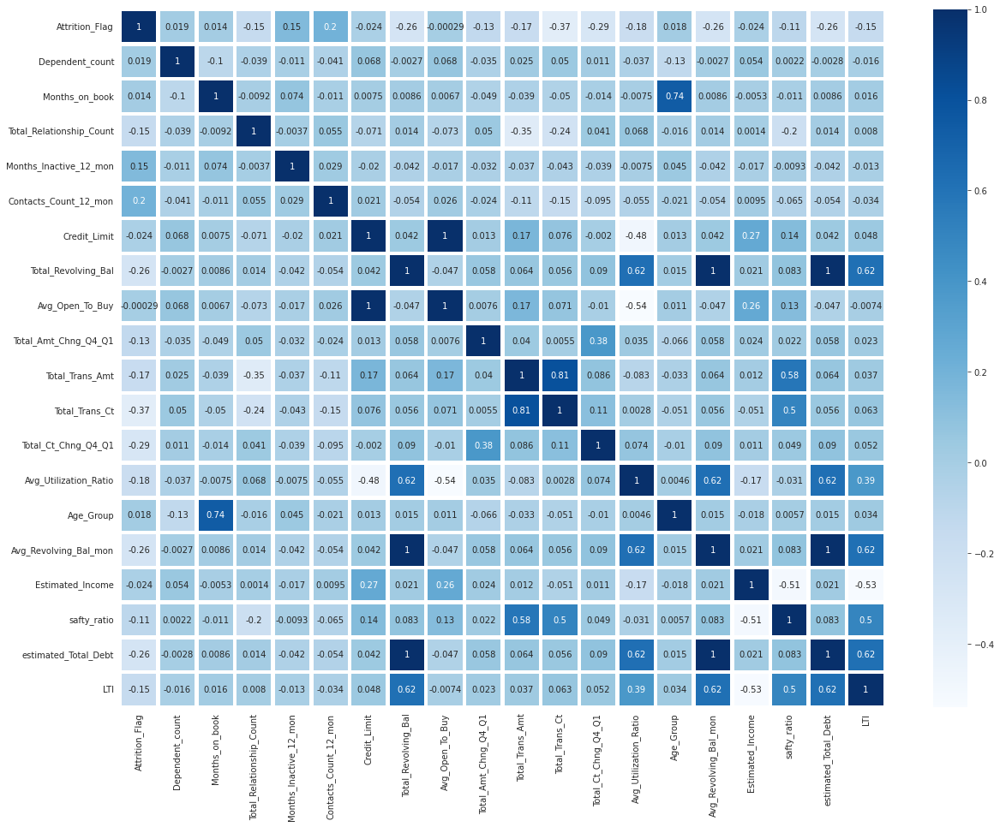

In [115]:
plt.figure(figsize=(20,15))
sns.heatmap(df.corr(), annot=True, cmap="Blues",linewidths=3.5,
    linecolor='white')


# 데이터프레임 순서 정렬하기

추후에 분석하기 쉽도록 고객의 인구통계적지표와 금융활동지표끼리 묶어 정렬한다.

In [116]:
df.columns

Index(['Attrition_Flag', 'Gender', 'Dependent_count', 'Education_Level',
       'Marital_Status', 'Income_Category', 'Card_Category', 'Months_on_book',
       'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio',
       'Age_Group', 'Avg_Revolving_Bal_mon', 'Estimated_Income', 'safty_ratio',
       'estimated_Total_Debt', 'LTI'],
      dtype='object')

In [118]:
new_df = df[['Attrition_Flag','Gender', 'Age_Group','Dependent_count', 'Education_Level','Marital_Status',
             'Card_Category','Months_on_book','Total_Relationship_Count', 'Months_Inactive_12_mon',
             'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal','Avg_Open_To_Buy',
             'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt','Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio',
             'Estimated_Income', 'safty_ratio','estimated_Total_Debt', 'LTI'     
         ]]

In [119]:
new_df.head(10)

,Attrition_Flag,Gender,Age_Group,Dependent_count,Education_Level,Marital_Status,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Estimated_Income,safty_ratio,estimated_Total_Debt,LTI
0,0,M,40,3,High School,Married,Blue,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,70000,0.016526,774.151,0.011059
1,0,F,40,5,Graduate,Single,Blue,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,20000,0.067464,866.880,0.043344
2,0,M,50,3,Graduate,Married,Blue,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,100000,0.018870,0.000,0.000000
3,0,F,40,4,High School,Unknown,Blue,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,20000,0.066979,2517.880,0.125894
4,0,M,40,3,Uneducated,Married,Blue,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000,70000,0.011657,0.000,0.000000
5,0,M,40,2,Graduate,Married,Blue,36,3,1,2,4010.0,1247,2763.0,1.376,1088,24,0.846,0.311,50000,0.022317,1247.110,0.024942
6,0,M,50,4,Unknown,Married,Gold,46,6,1,3,34516.0,2264,32252.0,1.975,1330,31,0.722,0.066,10000,0.171923,2278.056,0.227806
7,0,M,30,0,High School,Unknown,Silver,27,2,2,2,29081.0,1396,27685.0,2.204,1538,36,0.714,0.048,70000,0.022419,1395.888,0.019941
8,0,M,30,3,Uneducated,Single,Blue,36,5,2,0,22352.0,2517,19835.0,3.355,1350,24,1.182,0.113,70000,0.020005,2525.776,0.036083
9,0,M,40,2,Graduate,Single,Blue,36,6,3,3,11656.0,1677,9979.0,1.524,1441,32,0.882,0.144,100000,0.014656,1678.464,0.016785


In [121]:
new_df.to_csv('new_CardChurn.csv')

# 인코딩하기

# 스케일링하기

# 분석을 위해 상관관계가 높고 유의미한 지표들을 따로 모아 df로 만들기

# Random Under Sampling

타겟이 불균형하기 대문에 불균형 데이터를 무작위 언더 샘플링 혻은 Tomek link로 언더샘플링하기

# 기준 모델 만들기

# 모델 만들기

# 모델 평가하기

## Permutation Importance

## shap